---
# Setup

In [2]:
%%capture
! pip install pytorch-lightning
! pip install torchmetrics
! pip install adversarial-robustness-toolbox
# ! pip install cleverhans
! pip install matplotlib==3.4.3 # Restart runtime after running this
# ! pip install pytorch-lightning-bolts

! pip install methodtools
! pip install pathos

In [1]:
import os
from os import listdir
from natsort import natsorted
import gc # In case memory runs out, we can use gc.collect()
from tqdm import tqdm

import functools
from methodtools import lru_cache
from pathos.pools import ProcessPool

import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader, Subset, RandomSampler, ConcatDataset
from torchvision.models import vgg16, resnet50
from torchvision import transforms
from torchvision.io import read_image
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from torchmetrics import Accuracy

import numpy as np
import tensorboard as tb
import matplotlib.pyplot as plt
import pickle
import pandas as pd

from art.attacks.evasion import ProjectedGradientDescentPyTorch, FastGradientMethod, DeepFool as DeepFool_
from art.estimators.classification import PyTorchClassifier

---
# Data

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Path to the directory containing the project files (CHANGE THIS PATH TO THE DIRECTORY ON YOUR COMPUTER)
PROJECT_ROOT_DIR = 'drive/MyDrive/Colab Notebooks/AML/'

# Path to the directory containing the dataset (DOWNLOAD THE GTSRB_DATASET DIRECTORY FROM THE SHARED FOLDER ON ONE DRIVE)
DATA_DIR = 'LFW-dataset/'

In [5]:
class LFWDataset(Dataset):
    def __init__(self, which_set, transform=None):
        if which_set == "train":
            dir = PROJECT_ROOT_DIR+DATA_DIR+'Train/'
            csv = 'train_labels.csv'
        elif which_set == "val":
            dir = PROJECT_ROOT_DIR+DATA_DIR+'Validation/'
            csv = 'val_labels.csv'
        elif which_set == "test":
            dir = PROJECT_ROOT_DIR+DATA_DIR+'Test/'
            csv = 'test_labels.csv'
        
        files_list = natsorted(listdir(dir))

        with ProcessPool(nodes=5) as p:
            self.images = list(p.map(lambda x: read_image(dir+x), files_list))
        self.labels = torch.from_numpy(pd.read_csv(PROJECT_ROOT_DIR+DATA_DIR+csv, header=None).values.flatten()).long()

        self.transform = transform
    
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
         image = self.images[idx]
         label = self.labels[idx]
         if self.transform:
             image = self.transform(image)
         return image, label

In [6]:
train_data = LFWDataset(which_set='train', transform=transforms.Lambda(lambda x: x/255))
val_data = LFWDataset(which_set='val', transform=transforms.Lambda(lambda x: x/255))
test_data = LFWDataset(which_set='test', transform=transforms.Lambda(lambda x: x/255))

In [7]:
class MySubset(Subset):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.labels = None
    
    def __getitem__(self, idx):
        if self.labels is not None:
            return super().__getitem__(idx)[0], self.labels[idx]
        else:
            return super().__getitem__(idx)
        

In [8]:
np.random.seed(2)

ind = np.random.randint(1, 1000, 100)

# Set of image for testing the attacks
adv_test = MySubset(test_data, ind)

##############################################
# Creating adversarial train sets of images

# Set of images for training the detector with FGSM
adv_train_fgsm = train_data

# Set of images for training the detector with PGD
pgd_ind = np.random.randint(1, 3000, 1000)

adv_train_pgd = MySubset(train_data, pgd_ind)

# Set of images for training the detector with DeepFool
df_ind = np.random.randint(1, 3000, 100)
adv_train_df = MySubset(train_data, df_ind)

##############################################
# The image to use for clarifai
# clarifai_img = np.expand_dims(imgs_test[980], axis=0)
# Note that we needed to use expand_dims to make the shape (1,100,100,3)
# So that the array will be a batch size with one imag

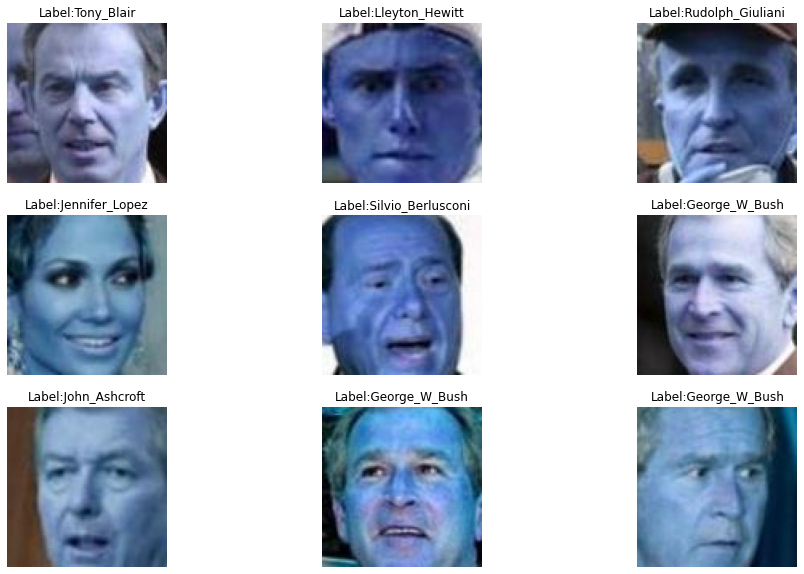

In [ ]:
# Read the sign names
signnames = pd.read_csv(PROJECT_ROOT_DIR + 'LFW-dataset/name_list.csv').values[:, 1]

# Plot a few images to check if the data makes sense (note that the quality of some of the images is pretty low)
plt.figure(figsize=(16, 10))

train_dataloader = DataLoader(train_data)
data = iter(train_dataloader)
for n in range(9):
    # i = np.random.randint(0, len(train_dataloader))
    ax = plt.subplot(3, 3, n+1)

    features, labels = next(data)
    img = features[0].permute(1, 2, 0).squeeze()
    plt.imshow(img)
    plt.title('Label:' + str(signnames[labels]))
    plt.axis('off')

---
# Task 1

## Model

In [9]:
class VGG16(pl.LightningModule):

    def __init__(self, learning_rate, batch_size,
                 training_data, validation_data, testing_data, pretrained=True):
        super().__init__()
        self.save_hyperparameters()

        self.pretrained = pretrained
        self.learning_rate = learning_rate
        self.batch_size = batch_size
        self.training_data = training_data
        self.validation_data = validation_data
        self.testing_data = testing_data

        self.vgg16 = vgg16(pretrained=self.pretrained)
        # for param in self.vgg16.parameters():
        #     param.requires_grad = False
        self.vgg16.classifier._modules['6'] = nn.Linear(4096, 62)
        self.criterion = nn.CrossEntropyLoss()
        self.accuracy = Accuracy()

    def forward(self, x):
        x = self.vgg16(x)
        return x

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_pred = self(x)
        loss = self.criterion(y_pred, y)
        self.log('train_loss', loss, on_epoch=True)
        self.log('train_acc', self.accuracy(y_pred.argmax(dim=1), y),
                 on_epoch=True, on_step=False)
        return loss
    
    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_pred = self(x)
        # x = x.view(x.size(0), -1)
        loss = self.criterion(y_pred, y)
        self.log('val_loss', loss)
        self.log('val_acc', self.accuracy(y_pred.argmax(dim=1), y))

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_pred = self(x)
        loss = self.criterion(y_pred, y)
        self.log('test_loss', loss)
        self.log('test_acc', self.accuracy(y_pred.argmax(dim=1), y))

    def predict_step(self, batch, batch_idx, dataloader_idx):
        x, y = batch
        y_pred = self(x)
        return y_pred

    def train_dataloader(self):
        return DataLoader(self.training_data, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.validation_data, batch_size=self.batch_size)

    def test_dataloader(self):
        return DataLoader(self.testing_data, batch_size=self.batch_size)

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        return optimizer

## Train

In [ ]:
checkpoint_callback = ModelCheckpoint(monitor="val_acc", mode="max")
vgg = VGG16(1e-4, 32, train_data, val_data, test_data, pretrained=True)
trainer = pl.Trainer(gpus=1, max_epochs=10,
                     callbacks=[checkpoint_callback])
trainer.fit(vgg)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/parsing.py:104: UserWarning: attribute 'training_data' removed from hparams because it cannot be pickled
  rank_zero_warn(f"attribute '{k}' removed from hparams because it cannot be pickled")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/parsing.py:104: UserWarning: attribute 'validation_data' removed from hparams because it cannot be pickled
  rank_zero_warn(f"attribute '{k}' removed from hparams because it cannot be pickled")
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/parsing.py:104: UserWarning: attribute 'testing_data' removed from hparams because it cannot be pickled
  rank_zero_warn(f"attribute '{k}' removed from hparams because it cannot be pickled")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
----------------------------

Validation sanity check: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
ls lightning_logs/version_1/checkpoints/

'epoch=9-step=959.ckpt'


In [ ]:
!mkdir drive/MyDrive/Colab\ Notebook/AML/Assignment2
!mkdir drive/MyDrive/Colab\ Notebook/AML/Assignment2/lightning_logs

In [ ]:
!cp -r lightning_logs/version_1 drive/MyDrive/Colab\ Notebooks/AML/Assignment2/lightning_logs/

## Training Loss and Accuracy
Note that the model checkpoint actually used for testing and inference is the epoch with the highest validation accuracy, epoch 9 (the final epoch, coincidentally)

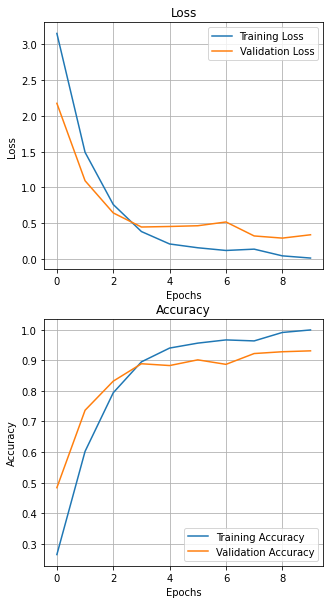

In [ ]:
train_loss_epoch = pd.read_csv('run-version_1-tag-train_loss_epoch.csv')
val_loss = pd.read_csv('run-version_1-tag-val_loss.csv')
train_acc = pd.read_csv('run-version_1-tag-train_acc.csv')
val_acc = pd.read_csv('run-version_1-tag-val_acc.csv')

fig, axs = plt.subplots(2, 1, figsize=(5, 10))
axs[0].plot(train_loss_epoch['Value'], label='Training Loss')
axs[0].plot(val_loss['Value'], label='Validation Loss')
axs[0].set_title('Loss')
axs[0].set_xlabel('Epochs')
axs[0].set_ylabel('Loss')
axs[0].legend()
axs[0].grid()

axs[1].plot(train_acc['Value'], label='Training Accuracy')
axs[1].plot(val_acc['Value'], label='Validation Accuracy')
axs[1].set_title('Accuracy')
axs[1].set_xlabel('Epochs')
axs[1].set_ylabel('Accuracy')
axs[1].legend()
axs[1].grid()
fig.show()

## Test Accuracy

In [ ]:
trainer.test() #(test_dataloaders=test_dataloader)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at /content/lightning_logs/version_1/checkpoints/epoch=9-step=959.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /content/lightning_logs/version_1/checkpoints/epoch=9-step=959.ckpt


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_acc': 0.9370829463005066, 'test_loss': 0.38173678517341614}
--------------------------------------------------------------------------------


[{'test_acc': 0.9370829463005066, 'test_loss': 0.38173678517341614}]

## Tensorboard

For the generation of the plots of loss and accuracy, the scalars were downloaded by checking "Show data download links" and then downloading the scalars for `train_loss_epoch`, `val_loss`, `train_acc`, and `val_acc`.

In [ ]:
# Start tensorboard.
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

Reusing TensorBoard on port 6006 (pid 1198), started 1:09:44 ago. (Use '!kill 1198' to kill it.)

<IPython.core.display.Javascript object>

## Load Saved Model

In [10]:
vgg = VGG16.load_from_checkpoint(PROJECT_ROOT_DIR+'Assignment2/lightning_logs/version_1/checkpoints/epoch=9-step=959.ckpt', training_data=train_data, validation_data=val_data, testing_data=test_data)

## Discussion

With VGG16 trained for 10 epochs on the LFW dataset, we achieve a training accuracy of 99.87%, a validation accuracy of 93.05%, and a test accuracy of 93.7%. Our trained method was to save the epoch with the best validation accuracy, which happened to be the last epoch.

---
# Task 2

PGD (Projected Gradient Descent) is performed for 40 iterations and the $\epsilon$ iterations is set to $2.5\epsilon/40$.

## Dataset Classes for Adversarial Examples

In [35]:
class AdversarialAttack(Dataset):
    def __init__(self, dataset, model, ep):
        model.eval()
        self.classifier = PyTorchClassifier(model=model, loss=model.criterion, nb_classes=62, input_shape=(3, 100, 100), device_type='gpu')

        # self.data = Subset(dataset, list(range(1000)))
        self.data = dataset
        # self.model = model
        self.ep = ep
        self.labels = None

    def __len__(self):
        return len(self.data)

    @lru_cache(maxsize=False)
    def __getitem__(self, idx):
        image, label = self.data.__getitem__(idx)
        adversarial_image = torch.from_numpy(self.attack.generate(image.unsqueeze(dim=0).numpy())) #, label))

        if self.labels is not None:
            label = self.labels[idx]

        return adversarial_image.squeeze(dim=0), label

class FGSM(AdversarialAttack):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.attack = FastGradientMethod(
            estimator=self.classifier,
            eps=self.ep,
            batch_size=1
        )

class PGD(AdversarialAttack):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.attack = ProjectedGradientDescentPyTorch(
            estimator=self.classifier,
            eps=self.ep,
            max_iter=40,
            eps_step=2.5*self.ep/40,
            batch_size=1,
            verbose=False
        )

class DeepFool(AdversarialAttack):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.attack = DeepFool_(
            classifier=self.classifier,
            epsilon=self.ep,
            batch_size=1,
            verbose=False
        )

## Code for Accuracy Calculations and Figure Generation

In [118]:
def adversarial_fig(adversarial_dataset, model):
    signnames = pd.read_csv(PROJECT_ROOT_DIR + 'LFW-dataset/name_list.csv').values[:, 1]

    # fig = plt.figure(constrained_layout=True) #, figsize=(16, 25))
    fig = plt.figure(figsize=(16, 10))
    subplots = fig.subplots(3, 3)
    fig.suptitle('Adversarial Images')

    adversarial = iter(DataLoader(adversarial_dataset, shuffle=True))
    for i in range(subplots.shape[0]):
        for j in range(subplots.shape[1]):
            features, labels = next(adversarial)
            predicted = model(features.to('cuda')).detach().to('cpu').argmax(dim=1)

            subplots[i][j].set_title('True label:' + str(signnames[labels]) + '\nPredicted label:' + str(signnames[predicted]))

            img = features[0].detach().to('cpu').squeeze().permute(1, 2, 0)
            subplots[i][j].imshow(img)
            subplots[i][j].axis('off')

In [16]:
def adversarial_inference(adversarial_dataset, model):
    accuracy = Accuracy()
    y_preds = []
    ys = []
    # fgsm_data = adversarial_dataset(data, model, ep)
    fgsm_dataloader = DataLoader(adversarial_dataset, batch_size=64)
    model.to('cuda')
    model.eval()
    
    for x, y in tqdm(fgsm_dataloader):
        x = x.to('cuda')
        y_preds.append(model(x.squeeze(0)).detach().to('cpu'))
        ys.append(y) 

    return accuracy(torch.cat(y_preds).argmax(dim=1), torch.cat(ys))

In [12]:
def inference(data, model):
    accuracy = Accuracy()
    y_preds = []
    ys = []
    dataloader = DataLoader(data, batch_size=64)
    model.to('cuda')
    model.eval()
    
    for x, y in tqdm(dataloader):
        x = x.to('cuda')
        y_preds.append(model(x.squeeze(0)).detach().to('cpu'))
        ys.append(y) 

    return accuracy(torch.cat(y_preds).argmax(dim=1), torch.cat(ys))

## Accuracies

### Clean

In [15]:
inference(adv_test, vgg)

  0%|          | 0/2 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
100%|██████████| 2/2 [00:00<00:00,  4.42it/s]


tensor(0.9600)

### FGSM

In [99]:
 adv_test_fgsm = FGSM(adv_test, vgg, 5/255)

In [25]:
adversarial_inference(adv_test_fgsm, vgg)

100%|██████████| 2/2 [00:02<00:00,  1.29s/it]


tensor(0.0100)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


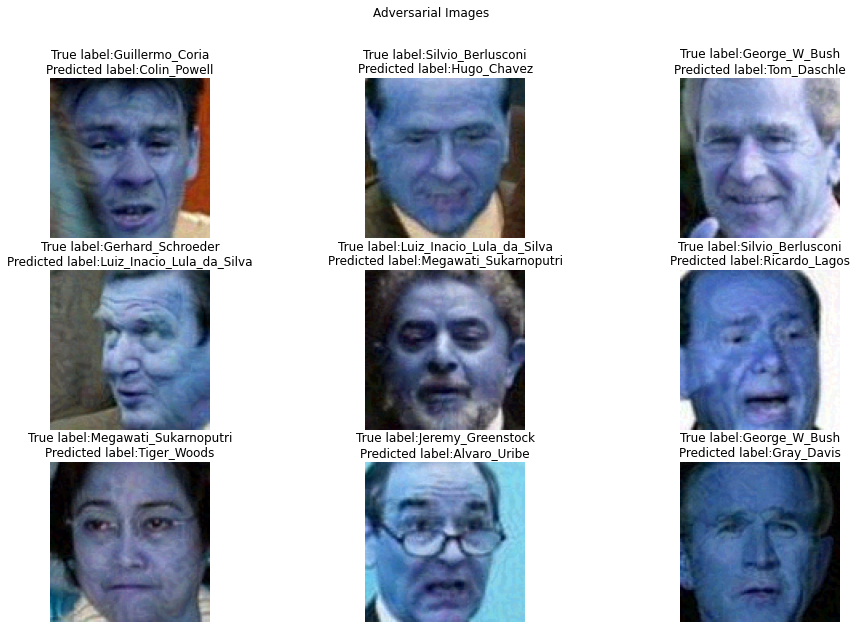

In [119]:
adversarial_fig(adv_test_fgsm, vgg)

### PGD

In [121]:
adv_test_pgd = PGD(adv_test, vgg, 5/255)

In [28]:
adversarial_inference(adv_test_pgd, vgg)

100%|██████████| 2/2 [00:54<00:00, 27.33s/it]


tensor(0.)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


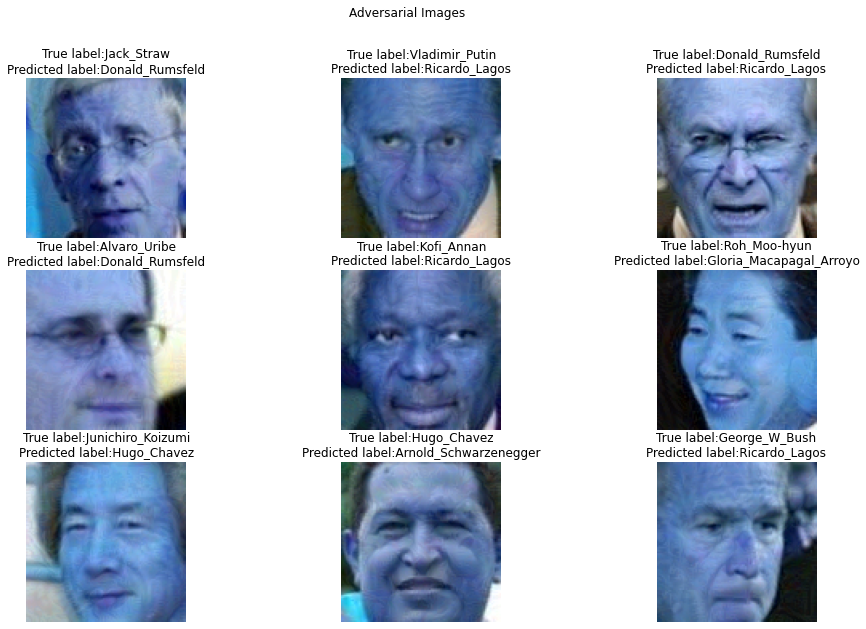

In [122]:
adversarial_fig(adv_test_pgd, vgg)

### DeepFool

In [123]:
adv_test_deepfool = DeepFool(adv_test, vgg, 5/255)

In [30]:
adversarial_inference(adv_test_deepfool, vgg)

100%|██████████| 2/2 [05:27<00:00, 163.92s/it]


tensor(0.1700)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


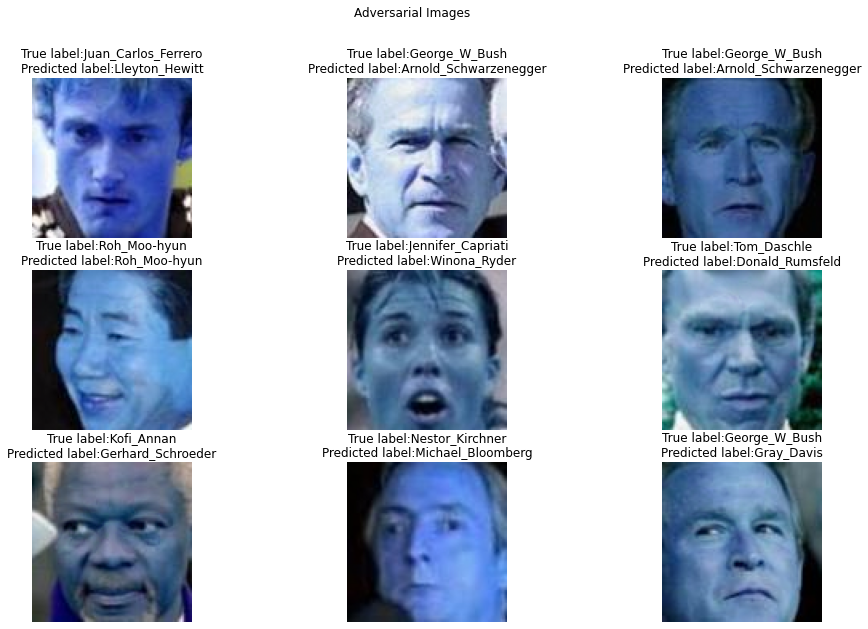

In [124]:
adversarial_fig(adv_test_deepfool, vgg)

## Discussion

As we can see in our results in Table 1, our results for the same perturbation level of $\epsilon = \frac{5}{255}$, PGD performs better than all the other attack methods, showing on a 0% accuracy rate on the set `adv_test`. DeepFool performs the worst, scoring a much heigher accuracy of 17% on `adv_test`. FGSM performs similarly to PGD, with a 1% accuracy. All attacks are quite effective. DeepFool has the least detectable adversarial examples by the naked eye, but this potentially comes at a cost of overall efficacy.

Comparing them accross different perturbations $\epsilon$ would help us determine which attack works best overall for the LFW dataset.

## Table 1

\begin{array}{|c|c|c|c|c|}
\hline
\textbf{Attack} & \text{Clean images ('adv_test')}
& \text{Adversarial images ('adv_test')}
& \text{Perturbation $\epsilon$} \\
\hline
\textbf{VGG16 - FGSM} & & 1\% & \frac{5}{255} \\ 
\textbf{VGG16 - PGD} & 96\% & 0\% & \frac{5}{255} \\
\textbf{VGG16 - DeepFool} & & 17\% & \frac{5}{255} \\
\hline
\end{array}

---
# Task 3

In [13]:
from copy import copy, deepcopy

class DetectorDataset(ConcatDataset):
    def __init__(self, clean_dataset, adversarial_dataset):
        clean = copy(clean_dataset)
        adversarial = copy(adversarial_dataset)
        clean.labels = torch.zeros(len(clean_dataset)).long()
        adversarial.labels = torch.ones(len(adversarial_dataset)).long()
        super().__init__([clean, adversarial])

    @lru_cache(maxsize=None)
    def __getitem__(self, idx):
        image, label = super().__getitem__(idx)
        return image, label

In [14]:
class Detector(pl.LightningModule):

    def __init__(self, learning_rate):
        super().__init__()
        self.save_hyperparameters()

        self.learning_rate = learning_rate

        self.vgg16 = deepcopy(vgg.vgg16) # Our previously trained VGG16 model
        self.vgg16.classifier._modules['6'] = nn.Linear(4096, 2)
        self.criterion = nn.CrossEntropyLoss()
        self.accuracy = Accuracy()

    def forward(self, x):
        x = self.vgg16(x)
        return x

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_pred = self(x)
        loss = self.criterion(y_pred, y)
        self.log('train_loss', loss, on_epoch=True)
        self.log('train_acc', self.accuracy(y_pred.argmax(dim=1), y),
                 on_epoch=True, on_step=False)
        return loss
    
    # def validation_step(self, batch, batch_idx):
    #     x, y = batch
    #     y_pred = self(x)
    #     # x = x.view(x.size(0), -1)
    #     loss = self.criterion(y_pred, y)
    #     self.log('val_loss', loss)
    #     self.log('val_acc', self.accuracy(y_pred.argmax(dim=1), y))

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_pred = self(x)
        loss = self.criterion(y_pred, y)
        self.log('test_loss', loss)
        self.log('test_acc', self.accuracy(y_pred.argmax(dim=1), y))

    def predict_step(self, batch, batch_idx, dataloader_idx):
        x, y = batch
        y_pred = self(x)
        return y_pred

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        return optimizer

In [113]:
def detector_inference(adversarial_dataset, model, clean=False, batch_size=64):
    accuracy = Accuracy()
    y_preds = []
    ys = []
    # fgsm_data = adversarial_dataset(data, model, ep)
    fgsm_dataloader = DataLoader(adversarial_dataset, batch_size=batch_size)
    model.to('cuda')
    model.eval()

    for x, y in tqdm(fgsm_dataloader):
        x = x.to('cuda')
        y_preds.append(model(x.squeeze(0)).detach().to('cpu'))
        if not clean:
            ys.append(torch.ones_like(y))
        else:
            ys.append(torch.zeros_like(y))
        
    print(torch.cat(y_preds).argmax(dim=1))
    return accuracy(torch.cat(y_preds).argmax(dim=1), torch.cat(ys))

In [55]:
checkpoint_callback = ModelCheckpoint(monitor="train_acc", mode="max")
early_stopping_callback = EarlyStopping(monitor='train_acc', mode='max', stopping_threshold=1, check_on_train_epoch_end=True)

## FGSM-Trained Detector

In [ ]:
train_clean = adv_train_fgsm
train_adv = FGSM(train_clean, vgg, 5/255)

In [32]:
train_detector_dataloader = DataLoader(DetectorDataset(train_clean, train_adv), batch_size=32, shuffle=True)

detector = Detector(1e-4)
detector_trainer = pl.Trainer(gpus=1, max_epochs=30,
                     callbacks=[checkpoint_callback, early_stopping_callback])
detector_trainer.fit(detector, train_detector_dataloader)

In [62]:
!ls drive/MyDrive/Colab\ Notebooks/AML/Assignment2/detector_logs/version_0/checkpoints

'epoch=4-step=954.ckpt'


### Load Saved Model

In [75]:
detector = Detector.load_from_checkpoint(PROJECT_ROOT_DIR+'Assignment2/detector_logs/version_0/checkpoints/epoch=4-step=954.ckpt')

### Accuracy of Clean adv_train_fgsm

In [114]:
detector_inference(adv_train_fgsm, detector) #, clean=True)

100%|██████████| 48/48 [00:02<00:00, 19.12it/s]

tensor([0, 0, 0,  ..., 0, 0, 0])


tensor(0.)

### Accuracy of Attacked adv_train_fgsm

In [115]:
detector_inference(train_adv, detector)

100%|██████████| 48/48 [01:25<00:00,  1.78s/it]

tensor([1, 1, 1,  ..., 1, 1, 1])


tensor(0.9970)

### Accuracy of Clean adv_test

In [103]:
detector_inference(adv_test, detector) #, clean=True)

100%|██████████| 2/2 [00:00<00:00, 21.18it/s]


tensor(0.)

### Accuracy of FGSM-Attacked adv_test

In [82]:
detector_inference(adv_test_fgsm, detector)

100%|██████████| 2/2 [00:02<00:00,  1.30s/it]


tensor(1.)

### Accuracy of PGD-Attacked adv_test

In [84]:
detector_inference(adv_test_pgd, detector)

100%|██████████| 2/2 [00:54<00:00, 27.40s/it]


tensor(0.9800)

### Accuracy of DeepFool-Attacked adv_test

In [85]:
detector_inference(adv_test_deepfool, detector)

100%|██████████| 2/2 [05:29<00:00, 164.64s/it]


tensor(0.)

### Success Rate with increasing $\epsilon$

In [91]:
eps = [1/255, 3/255, 5/255, 10/255, 20/255]

In [96]:
fgsm_vs_ep = list(map(lambda ep: detector_inference(FGSM(adv_test, vgg, ep), detector), eps))

100%|██████████| 2/2 [00:02<00:00,  1.29s/it]


In [98]:
fgsm_vs_ep

[tensor(0.), tensor(0.1700), tensor(1.), tensor(1.), tensor(1.)]

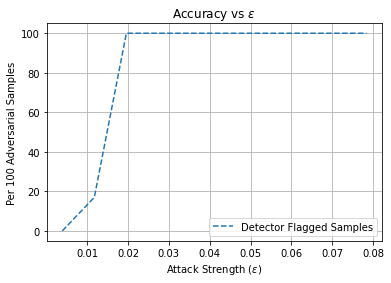

In [108]:
plt.plot(eps, list(map(lambda x: x*100, fgsm_vs_ep)), label='Detector Flagged Samples', linestyle='dashed')
plt.title(r'Accuracy vs $\epsilon$')
plt.xlabel(r'Attack Strength ($\epsilon$)')
plt.ylabel('Per 100 Adversarial Samples')
plt.legend()
plt.grid()

## PGD-Trained Detector

In [86]:
train_clean1 = adv_train_pgd
train_adv1 = PGD(train_clean1, vgg, 5/255)

In [ ]:
train_detector_dataloader1 = DataLoader(DetectorDataset(train_clean1, train_adv1), batch_size=32, shuffle=True)

detector1 = Detector(1e-4)
detector_trainer1 = pl.Trainer(gpus=1, max_epochs=30,
                     callbacks=[checkpoint_callback, early_stopping_callback])
detector_trainer1.fit(detector1, train_detector_dataloader1)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | vgg16     | VGG              | 134 M 
1 | criterion | CrossEntropyLoss | 0     
2 | accuracy  | Accuracy         | 0     
-----------------------------------------------
134 M     Trainable params
0         Non-trainable params
134 M     Total params
537.075   Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [64]:
!ls drive/MyDrive/Colab\ Notebooks/AML/Assignment2/detector_logs/version_1/checkpoints

'epoch=3-step=251.ckpt'


### Load Saved Model

In [82]:
detector1 = Detector.load_from_checkpoint(PROJECT_ROOT_DIR+'Assignment2/detector_logs/version_1/checkpoints/epoch=3-step=251.ckpt')

### Accuracy of Clean adv_train_pgd

In [101]:
detector_inference(adv_train_pgd, detector1) #, clean=True)

100%|██████████| 16/16 [00:00<00:00, 18.62it/s]


tensor(0.0060)

### Accuracy of Attacked adv_train_pgd

In [88]:
detector_inference(train_adv1, detector1)

100%|██████████| 16/16 [09:36<00:00, 36.06s/it]


tensor(1.)

### Accuracy of Clean adv_test

In [106]:
detector_inference(adv_test, detector1) # , clean=True)

100%|██████████| 2/2 [00:00<00:00, 21.12it/s]


tensor(0.0100)

### Accuracy of FGSM-Attacked adv_test

In [86]:
detector_inference(adv_test_fgsm, detector1)

100%|██████████| 2/2 [00:02<00:00,  1.29s/it]


tensor(1.)

### Accuracy of PGD-Attacked adv_test

In [83]:
detector_inference(adv_test_pgd, detector1)

100%|██████████| 2/2 [00:54<00:00, 27.38s/it]


tensor(1.)

### Accuracy of DeepFool-Attacked adv_test

In [87]:
detector_inference(adv_test_deepfool, detector1)

100%|██████████| 2/2 [05:29<00:00, 164.79s/it]


tensor(0.0100)

### Success Rate with increasing $\epsilon$

In [97]:
pgd_vs_ep = list(map(lambda ep: detector_inference(PGD(adv_test, vgg, ep), detector1), eps))

100%|██████████| 2/2 [00:54<00:00, 27.38s/it]


In [99]:
pgd_vs_ep

[tensor(0.0200), tensor(0.9200), tensor(1.), tensor(1.), tensor(1.)]

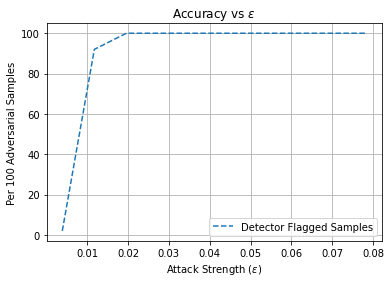

In [109]:
plt.plot(eps, list(map(lambda x: x*100, pgd_vs_ep)), label='Detector Flagged Samples', linestyle='dashed')
plt.title(r'Accuracy vs $\epsilon$')
plt.xlabel(r'Attack Strength ($\epsilon$)')
plt.ylabel('Per 100 Adversarial Samples')
plt.legend()
plt.grid()

## DeepFool-Trained Detector

In [95]:
train_clean2 = adv_train_df
train_adv2 = DeepFool(train_clean2, vgg, 5/255)

In [ ]:
# early_stopping_callback = EarlyStopping(monitor='train_acc', mode='max', min_delta=0.05, patience=5, stopping_threshold=1)
early_stopping_callback = EarlyStopping(monitor='train_acc', mode='max', patience=7, stopping_threshold=1, check_on_train_epoch_end=True)

train_detector_dataloader2 = DataLoader(DetectorDataset(train_clean2, train_adv2), batch_size=32, shuffle=True)

detector2 = Detector(2e-5)
detector_trainer2 = pl.Trainer(gpus=1, max_epochs=30,
                     callbacks=[checkpoint_callback, early_stopping_callback], log_every_n_steps=6)
detector_trainer2.fit(detector2, train_detector_dataloader2)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | vgg16     | VGG              | 134 M 
1 | criterion | CrossEntropyLoss | 0     
2 | accuracy  | Accuracy         | 0     
-----------------------------------------------
134 M     Trainable params
0         Non-trainable params
134 M     Total params
537.075   Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

### Load Saved Model

In [66]:
!ls drive/MyDrive/Colab\ Notebooks/AML/Assignment2/detector_logs/version_2/checkpoints

'epoch=26-step=188.ckpt'


In [92]:
detector2 = Detector.load_from_checkpoint(PROJECT_ROOT_DIR+'Assignment2/detector_logs/version_2/checkpoints/epoch=26-step=188.ckpt')

### Accuracy of Clean adv_train_df

In [107]:
detector_inference(adv_train_df, detector2) # , clean=True)

100%|██████████| 2/2 [00:00<00:00, 21.37it/s]


tensor(0.0300)

### Accuracy of Attacked adv_train_df

In [109]:
detector_inference(train_adv2, detector2)

100%|██████████| 2/2 [05:50<00:00, 175.02s/it]


tensor(0.9200)

### Accuracy of Clean adv_test

In [110]:
detector_inference(adv_test, detector2) #, clean=True)

100%|██████████| 2/2 [00:00<00:00, 22.47it/s]


tensor(0.3000)

### Accuracy of FGSM-Attacked adv_test

In [100]:
detector_inference(adv_test_fgsm, detector2)

100%|██████████| 2/2 [00:02<00:00,  1.41s/it]


tensor(0.7000)

### Accuracy of PGD-Attacked adv_test

In [89]:
detector_inference(adv_test_pgd, detector2)

100%|██████████| 2/2 [00:54<00:00, 27.39s/it]


tensor(0.1900)

### Accuracy of DeepFool-Attacked adv_test

In [90]:
detector_inference(adv_test_deepfool, detector2)

100%|██████████| 2/2 [05:30<00:00, 165.02s/it]


tensor(0.6900)

## Tensorboard

In [ ]:
!cp -a lightning_logs/. drive/MyDrive/Colab\ Notebooks/AML/Assignment2/detector_logs/

In [125]:
# Start tensorboard.
%load_ext tensorboard
%tensorboard --logdir drive/MyDrive/Colab\ Notebooks/AML/Assignment2/detector_logs

<IPython.core.display.Javascript object>

# Discussion

All models used the pretrained weights from training our original classifier. All models were trained for a maximum of 30 epochs and had early stopping. As before, we use the epoch with the best accuracy, but this time only using training accuracy. Our FGSM-trained model achieved a training accuracy of 99.85%, our PGD-trained model achieved a training accuracy of 98.81%, and our DeepFool model achieved an accuracy of 95.5%.

Our FGSM-trained binary input detector (trained at $\epsilon = \frac{5}{255}$) has a 100% success rate for FGSM samples and 98% for PGD. This intuitively makes sense that PGD would be a bit harder for an FGSM-trained detector, but it also makes sense that the results are quite comparable. It is unable to detect any DeepFool adversarial samples for $\frac{5}{255}$

Our PGD-trained detector (also trained at $\epsilon = \frac{5}{255}$) has a 100% success rate for both PGD samples and FGSM samples. This also intuively makes sense, since PGD uses FGSM. It performs slightly better on DeepFool than our FGSM-trained model, scoring a 1% success rate, but not significantly so.

Finally, our DeepFool-trained detector (also trained at $\epsilon = \frac{5}{255}$) is actually may be better at detecting FGSM attacks than DeepFool, with 70% and 69% respectively, but likely not significantly so. It is not particularly good at detecting PGD samples, scoring a 19% success rate.

It appears that, overall, our DeepFool-trained detector generalizes for other types of attacks better than our other detectors, but the trade-off, at least at the perturbation level tested, appears to be a lower specific detection success rate.

It appears that PGD samples is easier to detect for lower perturbations $\epsilon$, although they both achieve the same success rate for $\frac{5}{255}$. More samples of different perturbation levels would help us better compare.

It would be also interesting to compare the success rate vs attack strength across different attack strengths for DeepFool like with FGSM and PGD. This would help us better determine the general efficacy of our binary input detector for each of these attacks.

It would also be interesting to compare success rate vs attack strength across different attack strengths of our detectors for attacks other than themselves (e.g., success rate vs attack strength of a FGSM-detector on. We compare for $\frac{5}{255}$, but more results would help us. It would be particulary interesting to see if a DeepFool-trained detector would still be better at detecting FGSM than DeepFool

## Table 2
Detection **success rate** by the Binary Input Detector

\begin{array}{|L|c|c|}
\hline
& \textbf{Clean train images (adv_train)} & \textbf{Attacked train images} & \textbf{Clean subset of test images (adv_test)} & \textbf{Attacked subset of test images} & \textbf{Subset of test images} & \textbf{Subset of test images} \\
& \textbf{(false positive rate)} & \textbf{(adv_train)} & \textbf{(false positive rate)} & \textbf{(adv_test)} & \textbf{(adv_test)} & \textbf{(adv_test)} \\
\hline
\textbf{FGSM} & 0\% & 99.7\% & 0\% & 100\% & \textbf{PGD: } 98\% & \textbf{DeepFool: } 0\%\\
\textbf{PGD} & 0.6\% & 0\% & 1\% & 100\% & \textbf{FGSM: } 100\% & \textbf{DeepFool: } 1\%\\
\textbf{DeepFool} & 3\% & 92\% & 30\% & 69\% & \textbf{FGSM: } 70\% & \textbf{PGD: } 19\% \\
\hline
\end{array}